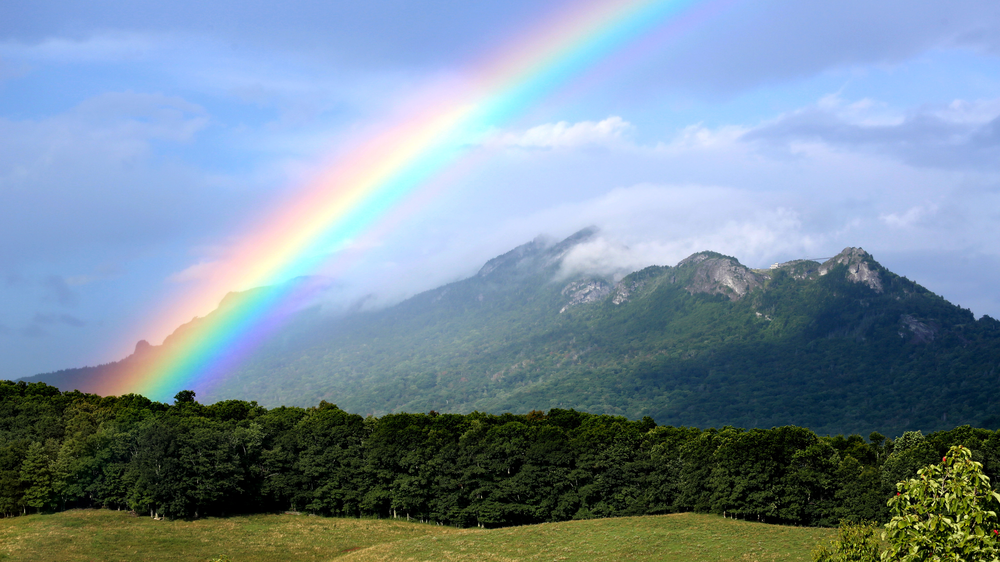

# <center>WeatherPy
----

## <center> Swati Oberoi Dham

In [2]:
# Dependencies and Setup
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import requests
import time
from scipy.stats import linregress
from pprint import pprint

# Import API key
from api_keys import weather_api_key

# Incorporated citipy to determine city based on latitude and longitude
from citipy import citipy

# Output File (CSV)
output_data_file = "output_data/cities.csv"

# Range of latitudes and longitudes
lat_range = (-90, 90)
lng_range = (-180, 180)

## Generate Cities List

In [3]:
# List for holding lat_lngs and cities
lat_lngs = []
cities = []

# Create a set of random lat and lng combinations
lats = np.random.uniform(lat_range[0], lat_range[1], size=1500)
lngs = np.random.uniform(lng_range[0], lng_range[1], size=1500)
lat_lngs = zip(lats, lngs)

# Identify nearest city for each lat, lng combination
for lat_lng in lat_lngs:
    city = citipy.nearest_city(lat_lng[0], lat_lng[1]).city_name
    
    # If the city is unique, then add it to a our cities list
    if city not in cities:
        cities.append(city)

# Print the city count to confirm sufficient count
print(len(cities))#615

625


### Perform API Calls
* Perform a weather check on each city using a series of successive API calls.
* Include a print log of each city as it'sbeing processed (with the city number and city name).


In [21]:
cid = []
cloud =[] 
country =[] 
cdate = []
hum = []
lat_list = [] 
lng_list = []
temp_max = []
wspeed = []
dt = []
citi_final = []
count = 0
myset = 1
url = "http://api.openweathermap.org/data/2.5/weather?"
units = 'imperial'

print('Beginning Data Retrieval\n-----------------------------')
for each_citi in cities:
    try:
       
        final_url = (f"{url}q={each_citi}&appid={weather_api_key}&units={units}")
        response = requests.get(final_url)
        data =response.json()
        citi_final.append(data['name'])
        dt.append(data['dt'])
        cloud.append(data['clouds']['all'])
        country.append(data['sys']['country'])
        cdate.append(data['dt'])
        hum.append(data['main']['humidity'])
        lng,lat = data['coord'].values()
        lat_list.append(lat)
        lng_list.append(lng)
        temp_max.append(data['main']['temp_max'])
        wspeed.append(data['wind']['speed'])
        print(f'Processing Record {count} of Set {myset} | {each_citi}')
        count+=1
        if count >49 :
            myset+=1
            count=0
    except:
        print('City not found. Skipping..')
        

print(f'-----------------------------\nData Retrieval Complete  \n-----------------------------\nTotal records of cities = {(len(citi_final))}')       

#597 records fetched

Beginning Data Retrieval
-----------------------------
Processing Record 0 of Set 1 | lagoa
Processing Record 1 of Set 1 | atuona
Processing Record 2 of Set 1 | severo-kurilsk
Processing Record 3 of Set 1 | mataura
Processing Record 4 of Set 1 | katsuura
Processing Record 5 of Set 1 | jamestown
Processing Record 6 of Set 1 | punta arenas
Processing Record 7 of Set 1 | mehamn
Processing Record 8 of Set 1 | avarua
Processing Record 9 of Set 1 | albany
Processing Record 10 of Set 1 | muros
Processing Record 11 of Set 1 | chilca
Processing Record 12 of Set 1 | yellowknife
Processing Record 13 of Set 1 | chokurdakh
Processing Record 14 of Set 1 | maceio
Processing Record 15 of Set 1 | ahipara
Processing Record 16 of Set 1 | butaritari
Processing Record 17 of Set 1 | mar del plata
Processing Record 18 of Set 1 | cape town
Processing Record 19 of Set 1 | tilichiki
City not found. Skipping..
Processing Record 20 of Set 1 | husavik
Processing Record 21 of Set 1 | amazar
Processing Record 22 of 

Processing Record 35 of Set 4 | clyde river
Processing Record 36 of Set 4 | los llanos de aridane
Processing Record 37 of Set 4 | kodiak
Processing Record 38 of Set 4 | sobolevo
City not found. Skipping..
Processing Record 39 of Set 4 | broome
Processing Record 40 of Set 4 | zhuanghe
Processing Record 41 of Set 4 | taoudenni
Processing Record 42 of Set 4 | carballo
Processing Record 43 of Set 4 | camacha
Processing Record 44 of Set 4 | puerto ayacucho
Processing Record 45 of Set 4 | mabaruma
Processing Record 46 of Set 4 | kananga
Processing Record 47 of Set 4 | alta floresta
City not found. Skipping..
Processing Record 48 of Set 4 | arrifes
Processing Record 49 of Set 4 | saint-philippe
Processing Record 0 of Set 5 | orange
Processing Record 1 of Set 5 | havoysund
Processing Record 2 of Set 5 | klin
Processing Record 3 of Set 5 | east london
Processing Record 4 of Set 5 | fukue
Processing Record 5 of Set 5 | san lorenzo de el escorial
Processing Record 6 of Set 5 | ginda
City not foun

Processing Record 25 of Set 8 | igunga
Processing Record 26 of Set 8 | abalak
Processing Record 27 of Set 8 | carbonia
Processing Record 28 of Set 8 | parchim
Processing Record 29 of Set 8 | asau
Processing Record 30 of Set 8 | baruun-urt
Processing Record 31 of Set 8 | aklavik
Processing Record 32 of Set 8 | teresina
Processing Record 33 of Set 8 | abu kamal
Processing Record 34 of Set 8 | samarai
Processing Record 35 of Set 8 | juegang
Processing Record 36 of Set 8 | kavieng
Processing Record 37 of Set 8 | araouane
Processing Record 38 of Set 8 | scarborough
Processing Record 39 of Set 8 | astana
Processing Record 40 of Set 8 | champerico
Processing Record 41 of Set 8 | owando
Processing Record 42 of Set 8 | butterworth
Processing Record 43 of Set 8 | vanimo
Processing Record 44 of Set 8 | qinhuangdao
City not found. Skipping..
Processing Record 45 of Set 8 | cam ranh
Processing Record 46 of Set 8 | tynda
Processing Record 47 of Set 8 | farrukhnagar
Processing Record 48 of Set 8 | ca

Processing Record 18 of Set 12 | warwick
Processing Record 19 of Set 12 | palu
Processing Record 20 of Set 12 | radis
Processing Record 21 of Set 12 | igarka
Processing Record 22 of Set 12 | mazara del vallo
Processing Record 23 of Set 12 | chacabuco
City not found. Skipping..
Processing Record 24 of Set 12 | basoko
Processing Record 25 of Set 12 | ploemeur
-----------------------------
Data Retrieval Complete  
-----------------------------
Total records of cities = 576


In [22]:
print(len(citi_final))

576


### Convert Raw Data to DataFrame
* Export the city data into a .csv.
* Display the DataFrame

In [24]:
df = pd.DataFrame({

    'City' : citi_final,
    'Cloudiness': cloud,
    'Country' : country,
    'Date': cdate,
    'Humidity': hum,
    'Lat': lat_list,
    'Lng':lng_list,
    'Max Temp': temp_max,
    'Wind Speed': wspeed,
    'Date' :dt
})
df.to_csv('../output_data/citi_swati.csv', index_label = 'City_ID')
df

,City,Cloudiness,Country,Date,Humidity,Lat,Lng,Max Temp,Wind Speed
0,Lagoa,31,PT,1611965951,78,39.0500,-27.9833,59.23,11.70
1,Atuona,6,PF,1611965952,75,-9.8000,-139.0333,78.71,18.52
2,Severo-Kuril'sk,99,RU,1611965952,91,50.6789,156.1250,22.59,15.35
3,Mataura,36,NZ,1611965990,44,-46.1927,168.8643,64.92,2.28
4,Katsuura,20,JP,1611965990,36,35.1333,140.3000,41.00,16.11
...,...,...,...,...,...,...,...,...,...
571,Igarka,52,RU,1611966098,75,67.4667,86.5833,-30.37,3.44
572,Mazara del Vallo,20,IT,1611966098,94,37.6641,12.5880,59.00,21.85
573,Chacabuco,24,AR,1611966099,81,-34.6417,-60.4739,73.00,5.88
574,Basoko,95,CD,1611966099,84,1.2391,23.6160,74.19,2.93


In [98]:
df.describe()

,Cloudiness,Date,Humidity,Lat,Lng,Max Temp,Wind Speed
count,567.000000,5.670000e+02,567.000000,567.000000,567.000000,567.000000,567.000000
mean,52.813051,1.611948e+09,70.763668,22.890526,16.692783,46.215573,8.422011
std,41.597138,6.312993e+01,20.302149,32.546640,88.610561,36.333725,5.492905
min,0.000000,1.611947e+09,12.000000,-54.800000,-179.166700,-49.560000,0.290000
25%,1.000000,1.611948e+09,59.500000,-3.409050,-57.545400,24.800000,4.330000
50%,70.000000,1.611948e+09,77.000000,28.453200,20.866700,57.990000,7.490000
75%,97.000000,1.611948e+09,86.000000,49.562400,91.612600,76.080000,11.500000
max,100.000000,1.611948e+09,100.000000,78.218600,179.316700,98.060000,33.380000


## Inspect the data and remove the cities where the humidity > 100%.
----
Skip this step if there are no cities that have humidity > 100%. 

In [99]:
df.loc[df['Humidity']>100,:] # no data points with humidity >100% found in this iteration

,City,Cloudiness,Country,Date,Humidity,Lat,Lng,Max Temp,Wind Speed


In [100]:
new_df= df.loc[df['Humidity']<=100,:] 
len(new_df)

567

In [101]:
#  Get the indices of cities that have humidity over 100%.
outlier = df.loc[df['Humidity']>100,:].index
outlier

Int64Index([], dtype='int64')

In [102]:
# Make a new DataFrame equal to the city data to drop all humidity outliers by index.
# Passing "inplace=False" will make a copy of the city_data DataFrame, which we call "clean_city_data".
clean_city_data = df.drop(outlier)
clean_city_data


,City,Cloudiness,Country,Date,Humidity,Lat,Lng,Max Temp,Wind Speed
0,Saldanha,0,ZA,1611947695,89,-33.0117,17.9442,65.19,12.17
1,Ushuaia,75,AR,1611947695,70,-54.8000,-68.3000,42.80,23.02
2,Tegul'det,100,RU,1611947695,92,57.3064,88.1667,-1.37,6.67
3,Teluknaga,75,ID,1611947695,83,-6.0989,106.6381,77.00,11.50
4,Hobart,75,AU,1611947696,94,-42.8794,147.3294,60.80,6.91
...,...,...,...,...,...,...,...,...,...
562,Yellandu,1,IN,1611947810,84,17.6000,80.3333,67.95,3.09
563,Maunabo,0,PR,1611947810,74,18.0072,-65.8993,84.00,8.99
564,Timizart,0,DZ,1611947598,63,36.8000,4.2667,58.60,4.23
565,Alihe,99,CN,1611947811,84,50.5667,123.7167,-23.57,0.40


## Plotting the Data
* Use proper labeling of the plots using plot titles (including date of analysis) and axes labels.
* Save the plotted figures as .pngs.

## Latitude vs. Temperature Plot

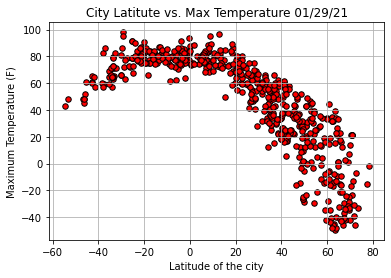

In [103]:
dt = pd.Timestamp.today().strftime('%m/%d/%y')
clean_city_data.plot('Lat','Max Temp', kind ='scatter', grid = True,c='r', title = 'City Latitute vs. Max Temperature '+dt, s = 30, edgecolors = 'black')
plt.title('City Latitute vs. Max Temperature ' + dt)
plt.xlabel('Latitude of the city')
plt.ylabel('Maximum Temperature (F)')

plt.show()


### The above scatter plot shows that the temperatures tend to drop around the extreme latitudes. We can observe lowest temperature around latitude 60-70 and highest temperature around the equator at latitude zero

## Latitude vs. Humidity Plot

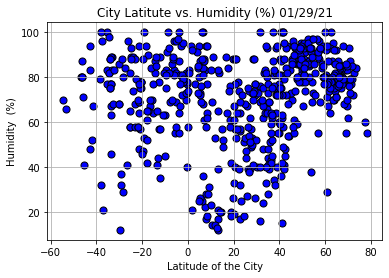

In [104]:
clean_city_data.plot('Lat','Humidity', kind ='scatter', xlabel = 'Latitude of the City',grid = True, c='b', title = 'City Latitute vs. Humidity (%) '+ dt,  s = 50, edgecolors = 'black')
plt.xlabel('Latitude of the City')
plt.ylabel('Humidity  (%)')
plt.show()

### In this plot of Humidity VS Latitude there is no clear pattern which can be observed. Highest values of humidity seems to be around the poles and lowest values around the equator. Other than that there is no clear inference that can be drawn from this plat.

## Latitude vs. Cloudiness Plot

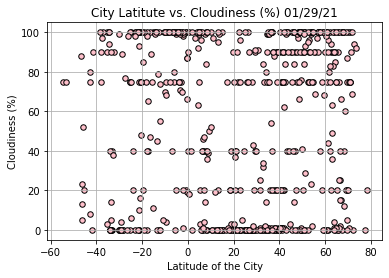

In [105]:

clean_city_data.plot('Lat','Cloudiness', kind ='scatter', grid = True, c='pink',title = 'City Latitute vs. Cloudiness (%) '+dt, s = 30, edgecolors = 'black')
plt.xlabel('Latitude of the City')
plt.ylabel('Cloudiness (%)')
plt.show()

### Once again in the cloudiness vs Latitude data set shows no relatioship positive or negative between the variables and the data points are randomly distributed.

## Latitude vs. Wind Speed Plot

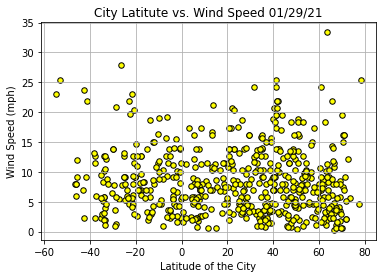

In [106]:

clean_city_data.plot('Lat','Wind Speed', kind ='scatter', grid = True, c='yellow',title = 'City Latitute vs. Wind Speed '+dt, s = 30, edgecolors = 'black')
plt.xlabel('Latitude of the City')
plt.ylabel('Wind Speed (mph)')
plt.show()

### The windspeed vales are mildly clustered around the 0-15 range with some of the polar locations having extreme values. But overall no strong correlation.

## Linear Regression

In [107]:
def regression_draw(x,y,x_axis,nx,ny):
    slope,inter, r, p, std = linregress(x,y)
    y_pred = x_axis*slope + inter
    plt.plot(x_axis,y_pred,c='r')
    plt.annotate(f'y ={str(round(slope,2))}x + {str(round(inter,2))} ', (nx,ny), c = 'r', fontsize = 15)
    print(f'The r value is {round(r,6)}')

####  Northern Hemisphere - Max Temp vs. Latitude Linear Regression

The r value is -0.858615


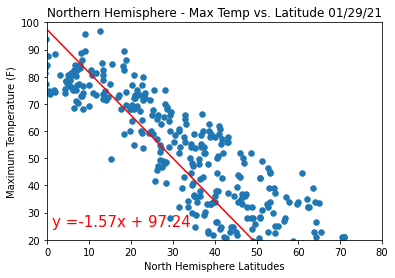

In [108]:
clean_city_data.plot('Lat','Max Temp', kind ='scatter',xlim=(0,80),ylim = (20,100), title = 'Northern Hemisphere - Max Temp vs. Latitude '+dt, s = 30)
y = clean_city_data.loc[clean_city_data['Lat']>0,'Max Temp']
x= clean_city_data.loc[clean_city_data['Lat']>0,'Lat']
x_axis = np.arange(0,80)
nx = 1
ny = 25
plt.xlabel('North Hemisphere Latitudes')
plt.ylabel('Maximum Temperature (F)')
regression_draw(x,y,x_axis,nx,ny)

### In the Northern Hemisphere, there is a strong negative correlation between the latitude and the Maximum Temperature. This implies that as the latitude of the place increases the maximum temperature decreases.

####  Southern Hemisphere - Max Temp vs. Latitude Linear Regression

The r value is 0.600062


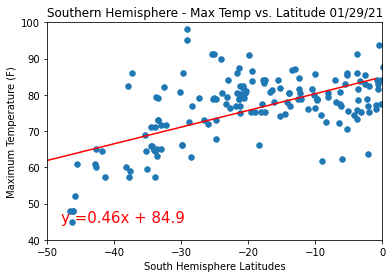

In [109]:
clean_city_data.plot('Lat','Max Temp', kind ='scatter',xlim=(-50,0),ylim = (40,100), title = 'Southern Hemisphere - Max Temp vs. Latitude '+dt, s = 30)
y = clean_city_data.loc[clean_city_data['Lat']<0,'Max Temp']
x= clean_city_data.loc[clean_city_data['Lat']<0,'Lat']
x_axis = np.arange(-60,0)
nx = -48
ny = 45
plt.xlabel('South Hemisphere Latitudes')
plt.ylabel('Maximum Temperature (F)')
regression_draw(x,y,x_axis,nx,ny)

### There is a weak positive correlation between the latitude and the max temperature of the place in the Southern Hemisphere. 

####  Northern Hemisphere - Humidity (%) vs. Latitude Linear Regression

The r value is 0.402971


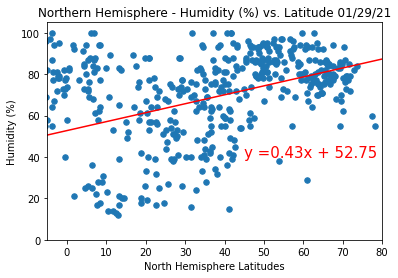

In [110]:
clean_city_data.plot('Lat','Humidity', kind ='scatter', xlim=(-5,80), ylim=(0,105), title = 'Northern Hemisphere - Humidity (%) vs. Latitude ' +dt, s = 30)
y = clean_city_data.loc[clean_city_data['Lat']>0,'Humidity']
x= clean_city_data.loc[clean_city_data['Lat']>0,'Lat']
x_axis = np.arange(-5,85)
nx= 45
ny = 40
plt.xlabel('North Hemisphere Latitudes')
plt.ylabel('Humidity (%)')

regression_draw(x,y,x_axis,nx,ny)

### The graph is mostly scattered and shows a weak positive correlation between Humidity VS Latitude in the Northern Hemisphere

####  Southern Hemisphere - Humidity (%) vs. Latitude Linear Regression

The r value is 0.097043


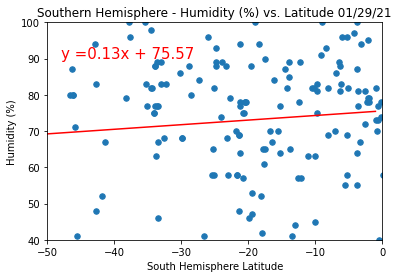

In [111]:
clean_city_data.plot('Lat','Humidity', kind ='scatter',xlim=(-50,0),ylim = (40,100), title = 'Southern Hemisphere - Humidity (%) vs. Latitude '+dt, s = 30)
y = clean_city_data.loc[clean_city_data['Lat']<0,'Humidity']
x= clean_city_data.loc[clean_city_data['Lat']<0,'Lat']
x_axis = np.arange(-50,0)
nx = -48
ny = 90
plt.xlabel('South Hemisphere Latitude')
plt.ylabel('Humidity (%)')

regression_draw(x,y,x_axis,nx,ny)

### In the Southern Hemisphere too the data points are mostly scattered and there is a weak positive correlation between Humidity and Latitude

####  Northern Hemisphere - Cloudiness (%) vs. Latitude Linear Regression

The r value is 0.200865


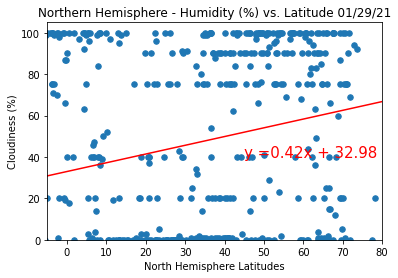

In [112]:
clean_city_data.plot('Lat','Cloudiness', kind ='scatter', xlim=(-5,80), ylim=(0,105), title = 'Northern Hemisphere - Humidity (%) vs. Latitude ' +dt, s = 30)
y = clean_city_data.loc[clean_city_data['Lat']>0,'Cloudiness']
x= clean_city_data.loc[clean_city_data['Lat']>0,'Lat']
x_axis = np.arange(-5,85)
nx = 45
ny = 40
plt.xlabel('North Hemisphere Latitudes')
plt.ylabel('Cloudiness (%)')

regression_draw(x,y,x_axis,nx,ny)

### In the northern hemisphere the data points are largely scatterd and there is a weak positive correlation between Cloudiness and Latitude

####  Southern Hemisphere - Cloudiness (%) vs. Latitude Linear Regression

The r value is 0.274137


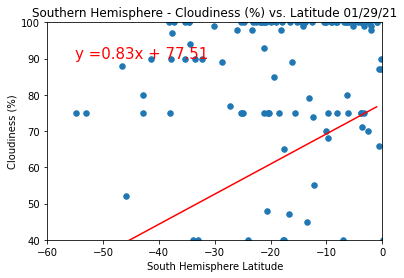

In [113]:
clean_city_data.plot('Lat','Cloudiness', kind ='scatter',xlim=(-60,0),ylim = (40,100), title = 'Southern Hemisphere - Cloudiness (%) vs. Latitude '+dt, s = 30)
y = clean_city_data.loc[clean_city_data['Lat']<0,'Cloudiness']
x= clean_city_data.loc[clean_city_data['Lat']<0,'Lat']
x_axis = np.arange(-80,0)
nx = -55
ny = 90
plt.xlabel('South Hemisphere Latitude')
plt.ylabel('Cloudiness (%)')
regression_draw(x,y,x_axis,nx,ny)


### The data points are scattered and show no major relationship between Latitude and Cloudiness in the Southern Hemisphre

####  Northern Hemisphere - Wind Speed (mph) vs. Latitude Linear Regression

The r value is -0.009517


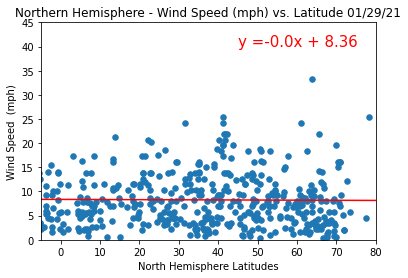

In [114]:
clean_city_data.plot('Lat','Wind Speed', kind ='scatter', xlim=(-5,80), ylim=(0,45), title = 'Northern Hemisphere - Wind Speed (mph) vs. Latitude ' +dt, s = 30)
y = clean_city_data.loc[clean_city_data['Lat']>0,'Wind Speed']
x= clean_city_data.loc[clean_city_data['Lat']>0,'Lat']
x_axis = np.arange(-5,85)
nx= 45
ny = 40
plt.xlabel('North Hemisphere Latitudes')
plt.ylabel('Wind Speed  (mph)')
regression_draw(x,y,x_axis,nx,ny)

### In the Northern Hemisphere, the data points are clusteres around the low values of wind speed. There is a weak positive relationship between the Wind Speed and the Latitude 

####  Southern Hemisphere - Wind Speed (mph) vs. Latitude Linear Regression

The r value is -0.116505


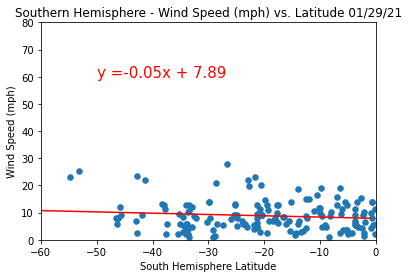

In [115]:
clean_city_data.plot('Lat','Wind Speed', kind ='scatter',xlim=(-60,0),ylim = (0,80), title = 'Southern Hemisphere - Wind Speed (mph) vs. Latitude '+dt, s = 30)
y = clean_city_data.loc[clean_city_data['Lat']<0,'Wind Speed']
x= clean_city_data.loc[clean_city_data['Lat']<0,'Lat']
x_axis = np.arange(-80,0)
nx = -50
ny = 60
plt.xlabel('South Hemisphere Latitude')
plt.ylabel('Wind Speed (mph)')
regression_draw(x,y,x_axis,nx,ny)

### In the Southern Hemisphere too the numbers are clustered around the lower wind speed and closer to the equator. There is a weak negative relationship between the wind speed and the latitude.